# Oliver Pan - Binance Data Scientist Intern

## Table of Contents:
* [Preliminary Data Analysis](#pa)
* [Part 1 Answers](#p1)
* [ML Modeling](#ml)
* [Part 2 Answers](#p2)
* [Closing Remarks](#cr)

Before we begin answering questions, I will first perform some basic data analysis on our test and train data to identify important attributes about our data. After we go through our analysis and findings, we can answer the questions with the required logic!

### Preliminary Data Analysis <a class="anchor" id="pa"></a>

#### Import Libraries & Data

In [1]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
from pandas_profiling import ProfileReport
pd.set_option('display.float_format', lambda x: '%.3f' % x)
import warnings
warnings.filterwarnings("ignore")

In [2]:
import six
import sys
sys.modules['sklearn.externals.six'] = six
import mlrose

In [3]:
from sklearn.metrics import f1_score,confusion_matrix,mean_absolute_error,precision_recall_curve
from sklearn.model_selection import GridSearchCV,RandomizedSearchCV
from sklearn.linear_model import LogisticRegression,LinearRegression
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.preprocessing import PolynomialFeatures
from xgboost import XGBClassifier, XGBRegressor
from skrules import SkopeRules
from sklearn.model_selection import train_test_split
from sklearn.metrics import auc,roc_curve
import statsmodels.api as sm

In [4]:
cs_train = pd.read_csv('GiveMeSomeCredit/cs-training.csv', index_col=[0])
cs_test = pd.read_csv('GiveMeSomeCredit/cs-test.csv', index_col=[0])

In [5]:
print("CS_TRAIN (ROWS, COLUMNS)")
print(cs_train.shape)
print("CS_TEST (ROWS, COLUMNS)")
print(cs_test.shape)

CS_TRAIN (ROWS, COLUMNS)
(150000, 11)
CS_TEST (ROWS, COLUMNS)
(101503, 11)


In [6]:
cs_train.head()

,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents
1,1,0.766,45,2,0.803,9120.000,13,0,6,0,2.000
2,0,0.957,40,0,0.122,2600.000,4,0,0,0,1.000
3,0,0.658,38,1,0.085,3042.000,2,1,0,0,0.000
4,0,0.234,30,0,0.036,3300.000,5,0,0,0,0.000
5,0,0.907,49,1,0.025,63588.000,7,0,1,0,0.000


In [7]:
cs_test.head()

,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents
1,NaN,0.886,43,0,0.178,5700.000,4,0,0,0,0.000
2,NaN,0.463,57,0,0.527,9141.000,15,0,4,0,2.000
3,NaN,0.043,59,0,0.688,5083.000,12,0,1,0,2.000
4,NaN,0.280,38,1,0.926,3200.000,7,0,2,0,0.000
5,NaN,1.000,27,0,0.020,3865.000,4,0,0,0,1.000


In [8]:
# cs_train and cs_test should have the same structure and data types
cs_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 150000 entries, 1 to 150000
Data columns (total 11 columns):
 #   Column                                Non-Null Count   Dtype  
---  ------                                --------------   -----  
 0   SeriousDlqin2yrs                      150000 non-null  int64  
 1   RevolvingUtilizationOfUnsecuredLines  150000 non-null  float64
 2   age                                   150000 non-null  int64  
 3   NumberOfTime30-59DaysPastDueNotWorse  150000 non-null  int64  
 4   DebtRatio                             150000 non-null  float64
 5   MonthlyIncome                         120269 non-null  float64
 6   NumberOfOpenCreditLinesAndLoans       150000 non-null  int64  
 7   NumberOfTimes90DaysLate               150000 non-null  int64  
 8   NumberRealEstateLoansOrLines          150000 non-null  int64  
 9   NumberOfTime60-89DaysPastDueNotWorse  150000 non-null  int64  
 10  NumberOfDependents                    146076 non-null  float64
dtype

In [9]:
cs_train.describe()

,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents
count,150000.000,150000.000,150000.000,150000.000,150000.000,120269.000,150000.000,150000.000,150000.000,150000.000,146076.000
mean,0.067,6.048,52.295,0.421,353.005,6670.221,8.453,0.266,1.018,0.240,0.757
std,0.250,249.755,14.772,4.193,2037.819,14384.674,5.146,4.169,1.130,4.155,1.115
min,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
25%,0.000,0.030,41.000,0.000,0.175,3400.000,5.000,0.000,0.000,0.000,0.000
50%,0.000,0.154,52.000,0.000,0.367,5400.000,8.000,0.000,1.000,0.000,0.000
75%,0.000,0.559,63.000,0.000,0.868,8249.000,11.000,0.000,2.000,0.000,1.000
max,1.000,50708.000,109.000,98.000,329664.000,3008750.000,58.000,98.000,54.000,98.000,20.000


In [10]:
cs_test.describe()

,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents
count,0.000,101503.000,101503.000,101503.000,101503.000,81400.000,101503.000,101503.000,101503.000,101503.000,98877.000
mean,NaN,5.310,52.405,0.454,344.475,6855.036,8.454,0.297,1.013,0.270,0.769
std,NaN,196.156,14.780,4.538,1632.595,36508.600,5.144,4.516,1.110,4.504,1.137
min,NaN,0.000,21.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
25%,NaN,0.030,41.000,0.000,0.173,3408.000,5.000,0.000,0.000,0.000,0.000
50%,NaN,0.153,52.000,0.000,0.364,5400.000,8.000,0.000,1.000,0.000,0.000
75%,NaN,0.564,63.000,0.000,0.852,8200.000,11.000,0.000,2.000,0.000,1.000
max,NaN,21821.000,104.000,98.000,268326.000,7727000.000,85.000,98.000,37.000,98.000,43.000


#### Exploratory Data Analysis

Here we can use Pandas Profiling to generate our initial data analysis, this provides a faster way for us to perform our exploratory data analysis, and gives us evidence and visualizations of what we can interpret.

In [11]:
ProfileReport(cs_train, title="CS Train Analysis")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [12]:
ProfileReport(cs_test, title="CS Test Analysis")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

#### Key Findings from Pandas Profiling <a class="anchor" id="kf"></a>

##### Missing Values

- CS_TRAIN -> MonthlyIncome  (29731,19.8%)

- CS_TRAIN -> NumberOfDependents (3924, 2.6%)

- CS_TEST -> MonthlyIncome (20103, 19.8%)

- CS_TRAIN -> NumberOfDependents (2626, 2.6%)

The majority of missing values are in the MonthlyIncome column. We can impute these values later, using methods such as median/mode/mean or a ML Model.

As well, in test, **SeriousDlqin2yrs** is fully missing, which makes sense since that is the value we are trying to predict.

<AxesSubplot:>

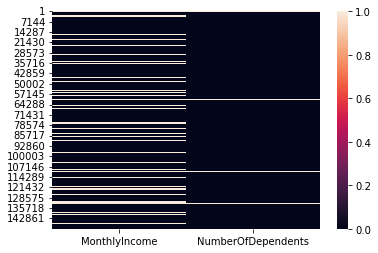

In [13]:
# This heatmap represents missing values in cs_train
sns.heatmap(cs_train[['MonthlyIncome', 'NumberOfDependents']].isna())

This makes sense with what we saw above. To repeat, we will find a way to inpute these values, potentially by predicting values using an ML Model.

##### Correlation

In [14]:
cs_train.corr()

,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents
SeriousDlqin2yrs,1.000,-0.002,-0.115,0.126,-0.008,-0.020,-0.030,0.117,-0.007,0.102,0.046
RevolvingUtilizationOfUnsecuredLines,-0.002,1.000,-0.006,-0.001,0.004,0.007,-0.011,-0.001,0.006,-0.001,0.002
age,-0.115,-0.006,1.000,-0.063,0.024,0.038,0.148,-0.061,0.033,-0.057,-0.213
NumberOfTime30-59DaysPastDueNotWorse,0.126,-0.001,-0.063,1.000,-0.007,-0.010,-0.055,0.984,-0.031,0.987,-0.003
DebtRatio,-0.008,0.004,0.024,-0.007,1.000,-0.029,0.050,-0.008,0.120,-0.008,-0.041
MonthlyIncome,-0.020,0.007,0.038,-0.010,-0.029,1.000,0.091,-0.013,0.125,-0.011,0.063
NumberOfOpenCreditLinesAndLoans,-0.030,-0.011,0.148,-0.055,0.050,0.091,1.000,-0.080,0.434,-0.071,0.065
NumberOfTimes90DaysLate,0.117,-0.001,-0.061,0.984,-0.008,-0.013,-0.080,1.000,-0.045,0.993,-0.010
NumberRealEstateLoansOrLines,-0.007,0.006,0.033,-0.031,0.120,0.125,0.434,-0.045,1.000,-0.040,0.125
NumberOfTime60-89DaysPastDueNotWorse,0.102,-0.001,-0.057,0.987,-0.008,-0.011,-0.071,0.993,-0.040,1.000,-0.011


#### Clean up missing values

Below is one approach, but we don't want to use this since we would be removing 20% of the dataset, since 20% of MonthlyIncome is missing!

``` cs_train = cs_train[~cs_train.isin([np.nan, np.inf, -np.inf]).any(1)] ```

Another approach would be to use an ML model such as RandomForest or XGBoost, so we can go ahead and pick one. I won't use mean because with 20% of the dataset missing, we would be setting the same value for all of them.

##### NumberOfDependents
Assuming that null means 0, which could be true...

In [15]:
cs_train['NumberOfDependents'].fillna(0, inplace = True)
cs_test['NumberOfDependents'].fillna(0, inplace = True)

##### MonthlyIncome

In [16]:
mi_train = cs_train.copy()
monthly_income_missing = mi_train[pd.isnull(mi_train["MonthlyIncome"])]
monthly_income = mi_train[~pd.isnull(mi_train["MonthlyIncome"])]
X_monthly_income_missing = monthly_income_missing.drop(['MonthlyIncome', 'SeriousDlqin2yrs'], axis = 1)
dlq_missing = monthly_income_missing['SeriousDlqin2yrs']
y_monthly_income_missing = monthly_income_missing['MonthlyIncome'] # Would be fully NAN
X_monthly_income = monthly_income.drop(['MonthlyIncome', 'SeriousDlqin2yrs'], axis = 1)
y_monthly_income = monthly_income['MonthlyIncome']

# ML Model to Predict
dtr = DecisionTreeRegressor()
dtr.fit(X_monthly_income, y_monthly_income)

DecisionTreeRegressor()

In [17]:
monthly_income_missing['MonthlyIncome'] = dtr.predict(X_monthly_income_missing).round(0)
monthly_income_missing['MonthlyIncome'].describe()

count    29731.000
mean       307.549
std       6441.401
min          0.000
25%          0.000
50%          0.000
75%          1.000
max     629000.000
Name: MonthlyIncome, dtype: float64

In [18]:
monthly_income_missing.head()

,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents
7,0,0.306,57,0,5710.000,1.000,8,0,3,0,0.000
9,0,0.117,27,0,46.000,0.000,2,0,0,0,0.000
17,0,0.061,78,0,2058.000,0.000,10,0,2,0,0.000
33,0,0.083,62,0,977.000,0.000,6,0,1,0,0.000
42,0,0.073,81,0,75.000,0.000,7,0,0,0,0.000


This matches up with above, we had 29731 missing values. To recap, we trained a model on the MonthlyIncome as the dependant variable, and used it to fill the missing values. Although a lot of our monthly incomes are 0, it could just mean that this person is unemployed, or something related.

In [19]:
cs_train = monthly_income.append(monthly_income_missing)

In [20]:
# Do it for cs_test too
mi_test = cs_test.copy()
monthly_income_missing = mi_test[pd.isnull(mi_test["MonthlyIncome"])]
monthly_income = mi_test[~pd.isnull(mi_test["MonthlyIncome"])]
X_monthly_income_missing = monthly_income_missing.drop(['MonthlyIncome', 'SeriousDlqin2yrs'], axis = 1)
y_monthly_income_missing = monthly_income_missing['MonthlyIncome'] # Would be fully NAN
X_monthly_income = monthly_income.drop(['MonthlyIncome', 'SeriousDlqin2yrs'], axis = 1)
y_monthly_income = monthly_income['MonthlyIncome']

dtr = DecisionTreeRegressor()
dtr.fit(X_monthly_income, y_monthly_income)

monthly_income_missing['MonthlyIncome'] = dtr.predict(X_monthly_income_missing).round(0)

In [21]:
cs_test = monthly_income.append(monthly_income_missing)

## Part 1 Answers <a class="anchor" id="p1"></a>

### What are the factors that have high correlation with the probability of loan default?

High correlation can be defined numerically as plus minus 0.5 to 1.0. We can use Pearson's correlation to find these values and variables, since we have numerical values

In [22]:
# Create a dataframe to 
cs_train_corr = cs_train.corr().abs().unstack().sort_values(kind="quicksort", ascending = False).to_frame().reset_index()
cs_train_corr.columns = ['Variable1', 'Variable2', 'Value']
cs_train_corr = cs_train_corr[cs_train_corr['Variable1'] != cs_train_corr['Variable2']]
cs_train_corr_high = cs_train_corr[cs_train_corr['Value'] >= 0.5]
cs_train_corr_high

,Variable1,Variable2,Value
11,NumberOfTime60-89DaysPastDueNotWorse,NumberOfTimes90DaysLate,0.993
12,NumberOfTimes90DaysLate,NumberOfTime60-89DaysPastDueNotWorse,0.993
13,NumberOfTime60-89DaysPastDueNotWorse,NumberOfTime30-59DaysPastDueNotWorse,0.987
14,NumberOfTime30-59DaysPastDueNotWorse,NumberOfTime60-89DaysPastDueNotWorse,0.987
15,NumberOfTimes90DaysLate,NumberOfTime30-59DaysPastDueNotWorse,0.984
16,NumberOfTime30-59DaysPastDueNotWorse,NumberOfTimes90DaysLate,0.984


From what we see here, none of the factors have high correlation with probability of loan default.

In [23]:
cs_train.corr()['SeriousDlqin2yrs'].to_frame()

,SeriousDlqin2yrs
SeriousDlqin2yrs,1.000
RevolvingUtilizationOfUnsecuredLines,-0.002
age,-0.115
NumberOfTime30-59DaysPastDueNotWorse,0.126
DebtRatio,-0.008
MonthlyIncome,-0.013
NumberOfOpenCreditLinesAndLoans,-0.030
NumberOfTimes90DaysLate,0.117
NumberRealEstateLoansOrLines,-0.007
NumberOfTime60-89DaysPastDueNotWorse,0.102


This justifies our analysis! If we had to look for a variable that gives us some sort of correlation, the top three variables would be **age**, **NumberOfTime30-59DaysPastDueNotWorse**, and **NumberOfTimes90DaysLate**.

### Are there interaction effects occurring among the variables?

We can use a simple ANOVA test to see if there are interaction effects among the variables. To recap, ANOVA is an analysis of variance. We can't exactly use an OLS statistical summary for our multi regression problem, since our dependent variable is binary, so we can use Logit, which is logistic regression.

In [24]:
import statsmodels.api as sml
X = cs_train.drop(columns = ['SeriousDlqin2yrs'], axis = 1)
y = cs_train['SeriousDlqin2yrs']

#### Logit

In [25]:
import statsmodels.api as sm
logit_model = sml.Logit(y,X).fit()
print(logit_model.summary2())

Optimization terminated successfully.
         Current function value: 0.228833
         Iterations 7
                                    Results: Logit
Model:                     Logit                   Pseudo R-squared:        0.067     
Dependent Variable:        SeriousDlqin2yrs        AIC:                     68669.8220
Date:                      2022-11-16 16:57        BIC:                     68769.0059
No. Observations:          150000                  Log-Likelihood:          -34325.   
Df Model:                  9                       LL-Null:                 -36808.   
Df Residuals:              149990                  LLR p-value:             0.0000    
Converged:                 1.0000                  Scale:                   1.0000    
No. Iterations:            7.0000                                                     
--------------------------------------------------------------------------------------
                                      Coef.  Std.Err.     z     

To quickly sum up what this is saying

    - All the variables are statistically significant except for RevolvingUtilizationOfUnsecuredLines
    - We use summary2() since it is an "experimental function to summarize regression results" over summary()
    - This is only interaction with SeriousDlqin2yrs, so we can use a library to create every possible combination

We will use OLS here, since SeriousDlqin2yrs was the only binary variable

#### OLS

In [26]:
X = cs_train.drop(columns = ['SeriousDlqin2yrs'], axis = 1)
y = cs_train['SeriousDlqin2yrs']
x_interaction = PolynomialFeatures(2, interaction_only=True, include_bias=False).fit_transform(X)
interactions = ['RevolvingUtilizationOfUnsecuredLines',
                'age',
                'NumberOfTime30-59DaysPastDueNotWorse',
                'DebtRatio',
                'MonthlyIncome',
                'NumberOfOpenCreditLinesAndLoans',
                'NumberOfTimes90DaysLate',
                'NumberRealEstateLoansOrLines',
                '89DaysPastDueNotWorse',
                'NumberOfDependents',
                'RevolvingUtilizationOfUnsecuredLines:age', 
                'RevolvingUtilizationOfUnsecuredLines:NumberOfTime30-59DaysPastDueNotWorse',
                'RevolvingUtilizationOfUnsecuredLines:DebtRatio',
                'RevolvingUtilizationOfUnsecuredLines:MonthlyIncome',
                'RevolvingUtilizationOfUnsecuredLines:NumberOfOpenCreditLinesAndLoans',
                'RevolvingUtilizationOfUnsecuredLines:NumberOfTimes90DaysLate',
                'RevolvingUtilizationOfUnsecuredLines:NumberRealEstateLoansOrLines',
                'RevolvingUtilizationOfUnsecuredLines:89DaysPastDueNotWorse',
                'RevolvingUtilizationOfUnsecuredLines:NumberOfDependents',
                'age:NumberOfTime30-59DaysPastDueNotWorse',
                'age:DebtRatio',
                'age:MonthlyIncome',
                'age:NumberOfOpenCreditLinesAndLoans',
                'age:NumberOfTimes90DaysLate',
                'age:NumberRealEstateLoansOrLines',
                'age:89DaysPastDueNotWorse',
                'age:NumberOfDependents',
                'NumberOfTime30-59DaysPastDueNotWorse:DebtRatio',
                'NumberOfTime30-59DaysPastDueNotWorse:MonthlyIncome',
                'NumberOfTime30-59DaysPastDueNotWorse:NumberOfOpenCreditLinesAndLoans',
                'NumberOfTime30-59DaysPastDueNotWorse:NumberOfTimes90DaysLate',
                'NumberOfTime30-59DaysPastDueNotWorse:NumberRealEstateLoansOrLines',
                'NumberOfTime30-59DaysPastDueNotWorse:89DaysPastDueNotWorse',
                'NumberOfTime30-59DaysPastDueNotWorse:NumberOfDependents',
                'DebtRatio:MonthlyIncome',
                'DebtRatio:NumberOfOpenCreditLinesAndLoans',
                'DebtRatio:NumberOfTimes90DaysLate',
                'DebtRatio:NumberRealEstateLoansOrLines',
                'DebtRatio:89DaysPastDueNotWorse',
                'DebtRatio:NumberOfDependents',
                'MonthlyIncome:NumberOfOpenCreditLinesAndLoans',
                'MonthlyIncome:NumberOfTimes90DaysLate',
                'MonthlyIncome:NumberRealEstateLoansOrLines',
                'MonthlyIncome:89DaysPastDueNotWorse',
                'MonthlyIncome:NumberOfDependents',
                'NumberOfOpenCreditLinesAndLoans:NumberOfTimes90DaysLate',
                'NumberOfOpenCreditLinesAndLoans:NumberRealEstateLoansOrLines',
                'NumberOfOpenCreditLinesAndLoans:89DaysPastDueNotWorse',
                'NumberOfOpenCreditLinesAndLoans:NumberOfDependents',
                'NumberOfTimes90DaysLate:NumberRealEstateLoansOrLines',
                'NumberOfTimes90DaysLate:89DaysPastDueNotWorse',
                'NumberOfTimes90DaysLate:NumberOfDependents',
                'NumberRealEstateLoansOrLines:89DaysPastDueNotWorse',
                'NumberRealEstateLoansOrLines:NumberOfDependents',
                '89DaysPastDueNotWorse:NumberOfDependents',    
               ]
interaction_df = pd.DataFrame(x_interaction, columns = interactions)

In [27]:
interaction_effects = sm.OLS(list(y), interaction_df).fit()

# Statistically Significant Results
interaction_effects.pvalues[interaction_effects.pvalues < 0.05]

age                                                                    0.000
NumberOfTime30-59DaysPastDueNotWorse                                   0.000
NumberOfOpenCreditLinesAndLoans                                        0.000
NumberOfTimes90DaysLate                                                0.000
89DaysPastDueNotWorse                                                  0.000
NumberOfDependents                                                     0.000
RevolvingUtilizationOfUnsecuredLines:NumberOfTimes90DaysLate           0.040
RevolvingUtilizationOfUnsecuredLines:89DaysPastDueNotWorse             0.003
age:NumberOfTime30-59DaysPastDueNotWorse                               0.000
age:NumberOfOpenCreditLinesAndLoans                                    0.000
age:NumberOfTimes90DaysLate                                            0.000
age:NumberRealEstateLoansOrLines                                       0.011
age:89DaysPastDueNotWorse                                              0.000

From above, those are the interaction affects that are statistically significant!

### Any other preliminary analysis of the given dataset?

#### SKOPE-Rules

We will introduce something called SKOPE Rules to help wrap up our preliminary analysis. To recall, we have already performed statistical tests, exploratory data analysis, and correlation tests. This is a Python package that assists us with understanding the logic of our dataset; we will use this is understand characteristics that lead to **SeriousDlqin2yrs**. We will use skope-rules because "this is the natural use of Skope-Rules, for a binary classification task. Rules isolate the 1s from 0s."

In [28]:
### SKOPE Rules
X = cs_train.drop(columns = ['SeriousDlqin2yrs'], axis = 1)
y = cs_train['SeriousDlqin2yrs']
clf = SkopeRules(max_depth_duplication=2,
                 n_estimators=30,
                 precision_min=0.3,
                 recall_min=0.1,
                 feature_names=list(X.columns))
clf.fit(X,y)

SkopeRules(feature_names=['RevolvingUtilizationOfUnsecuredLines', 'age',
                          'NumberOfTime30-59DaysPastDueNotWorse', 'DebtRatio',
                          'MonthlyIncome', 'NumberOfOpenCreditLinesAndLoans',
                          'NumberOfTimes90DaysLate',
                          'NumberRealEstateLoansOrLines',
                          'NumberOfTime60-89DaysPastDueNotWorse',
                          'NumberOfDependents'],
           max_depth_duplication=2, n_estimators=30, precision_min=0.3,
           recall_min=0.1)

In [29]:
print(str(len(clf.rules_)) + ' rules have been built.')
for rule in clf.rules_:
    print(rule[0])

3 rules have been built.
RevolvingUtilizationOfUnsecuredLines <= 1.0008464455604553 and NumberOfTimes90DaysLate > 1.5
RevolvingUtilizationOfUnsecuredLines > 0.3895404636859894 and NumberOfTimes90DaysLate <= 1.5 and NumberOfTimes90DaysLate > 0.5
DebtRatio > 0.12061411887407303 and NumberOfTimes90DaysLate > 1.5


Basically, this is saying that these combinations lead to potential **SeriousDlqin2yrs**

## Machine Learning Modeling <a class="anchor" id="ml"></a>

#### Train/Test Split

In [30]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.25, random_state = 0)

#### Using Base LogisticRegression

In [31]:
lr_base = LogisticRegression()
lr_base.fit(X_train,y_train)
lr_pred = lr_base.predict(X_test)
fpr,tpr,_ = roc_curve(y_test, lr_pred)
roc_auc = auc(fpr, tpr)
print("AUC Score:", roc_auc)
print("Score :", lr_base.score(X_train,y_train))

AUC Score: 0.5054663870321399
Score : 0.9333422222222222


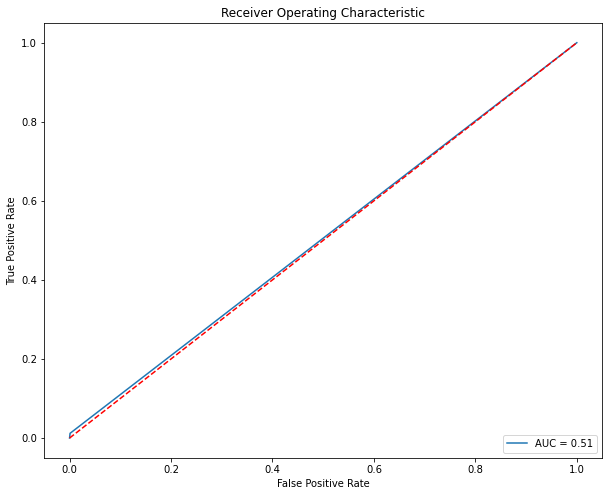

In [32]:
plt.figure(figsize=(10,8))
plt.title('Receiver Operating Characteristic')
sns.lineplot(fpr, tpr, label = 'AUC = %0.2f' % roc_auc)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

In [33]:
# SAMPLE SUBMISSION
pred = lr_base.predict_proba(cs_test.drop(['SeriousDlqin2yrs'], axis = 1))[:,1]
id_col = cs_test.index
col = [pred,id_col.values]
result = pd.DataFrame(list(zip(id_col, pred)),columns=["Id","Probability"])
result.head()

,Id,Probability
0,1,0.057
1,2,0.063
2,3,0.047
3,4,0.159
4,5,0.160


#### Using RandomForest

In [34]:
rf = RandomForestClassifier() 
rf.fit(X_train,y_train)
rf_pred = rf.predict(X_test)
fpr,tpr,_ = roc_curve(y_test, rf_pred)
roc_auc = auc(fpr, tpr)
print("AUC Score:", roc_auc)
rf_pred2 = rf.predict_proba(X_test)[:,0]
print("Score :", rf.score(X_train,y_train))

AUC Score: 0.58993102866786
Score : 0.9995733333333333


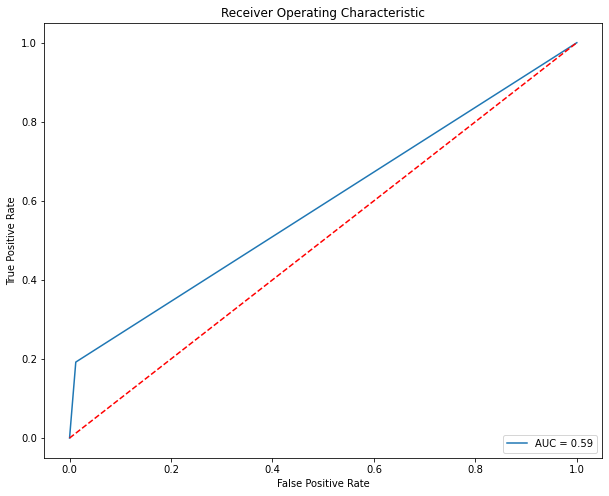

In [35]:
plt.figure(figsize=(10,8))
plt.title('Receiver Operating Characteristic')
sns.lineplot(fpr, tpr, label = 'AUC = %0.2f' % roc_auc)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

#### Using Base XGBoost

In [36]:
## Base Model
xgc_base = XGBClassifier()
xgc_base.fit(X_train,y_train)
xgc_pred = xgc_base.predict(X_test)
fpr,tpr,_ = roc_curve(y_test, xgc_pred)
roc_auc = auc(fpr, tpr)
print("AUC Score:", roc_auc)
xgc_pred2 = xgc_base.predict_proba(X_test)[:,0]
print("Score :", xgc_base.score(X_train,y_train))
print("F1 Score:", f1_score(y_test,xgc_pred))

AUC Score: 0.5916221585804455
Score : 0.9491288888888889
F1 Score: 0.28654800116720164


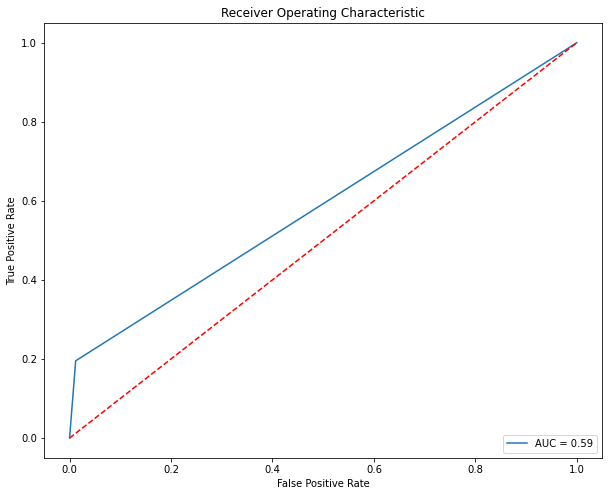

In [37]:
plt.figure(figsize=(10,8))
plt.title('Receiver Operating Characteristic')
sns.lineplot(fpr, tpr, label = 'AUC = %0.2f' % roc_auc)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

In [38]:
# SAMPLE SUBMISSION
pred = xgc_base.predict_proba(cs_test.drop(['SeriousDlqin2yrs'], axis = 1))[:,1]
id_col = cs_test.index
col = [pred,id_col.values]
result = pd.DataFrame(list(zip(id_col, pred)),columns=["Id","Probability"])
result.head()

,Id,Probability
0,1,0.076
1,2,0.033
2,3,0.012
3,4,0.071
4,5,0.083


#### Hyperparameter tuning with GridSearchCV

In [39]:
params = {
        'min_child_weight': [1, 5],
        'subsample': [0.6, 1.0],
        'max_depth': [3, 4, 5]
        }

In [40]:
clf = GridSearchCV(
        XGBClassifier(), params, scoring='accuracy'
    )
clf.fit(X_train, y_train)
print(clf.best_params_)

{'max_depth': 3, 'min_child_weight': 1, 'subsample': 1.0}


We will use the hyperparameter tuned model to produce our final result.

In [41]:
xgc = XGBClassifier(min_child_weight=5, subsample=1.0, max_depth=3) 
xgc.fit(X_train,y_train)
xgc_pred = xgc.predict(X_test)
fpr,tpr,_ = roc_curve(y_test, xgc_pred)
roc_auc = auc(fpr, tpr)
print("AUC Score:", roc_auc)
xgc_pred2 = xgc.predict_proba(X_test)[:,0]
print("Score :", xgc.score(X_train,y_train))
print("F1 Score:", f1_score(y_test,xgc_pred))

AUC Score: 0.5916138361242894
Score : 0.9397866666666667
F1 Score: 0.28988965105875336


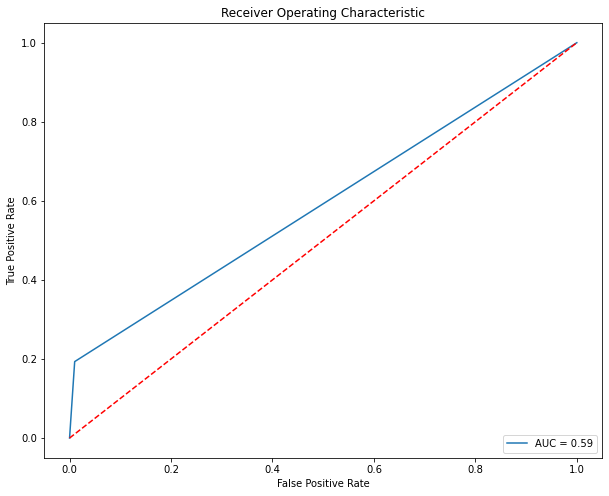

In [42]:
plt.figure(figsize=(10,8))
plt.title('Receiver Operating Characteristic')
sns.lineplot(fpr, tpr, label = 'AUC = %0.2f' % roc_auc)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

#### XGBoost Regression

We might be wondering why we would use regressor for a classification problem, but it is because we can sometimes see LogisticRegression as a regression problem, where calculating **probability** of a loan defaul a soft regression problem. Hence, we might as well try!

In [43]:
xgr = XGBRegressor(min_child_weight=5, subsample=1.0, max_depth=3) 
xgr.fit(X_train,y_train)
xgr_pred = xgr.predict(X_test)
fpr,tpr,_ = roc_curve(y_test, xgr_pred)
roc_auc = auc(fpr, tpr)
print("AUC Score:", roc_auc)

AUC Score: 0.8635116906178314


WOW, our AUC is very high. Maybe this can be our solution here, but I think we should stick with Classification!

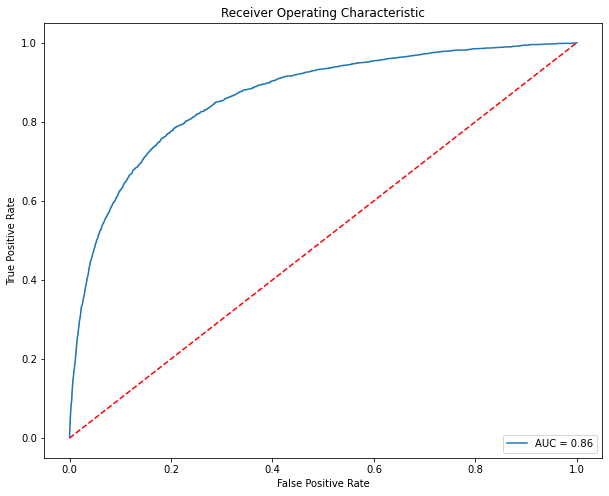

In [44]:
plt.figure(figsize=(10,8))
plt.title('Receiver Operating Characteristic')
sns.lineplot(fpr, tpr, label = 'AUC = %0.2f' % roc_auc)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

In [45]:
### Final Solution
pred = xgc.predict_proba(cs_test.drop(['SeriousDlqin2yrs'], axis = 1))[:,1]
id_col = cs_test.index
col = [pred,id_col.values]
result = pd.DataFrame(list(zip(id_col, pred)),columns=["Id","Probability"])
result.head()

,Id,Probability
0,1,0.072
1,2,0.039
2,3,0.016
3,4,0.083
4,5,0.100


In [46]:
result.to_csv('GiveMeSomeCredit/submission.csv', index = False)

In [47]:
result.shape

(101503, 2)

## Part 2 Answers <a class="anchor" id="p2"></a>

### Tell us how you validate your model and why you chose such evaluation technique(s).

During my analysis I used four model evaluation metrics, to essentially validate our model. Note that in our Regressor model, we only use AUC since regression problems do not compute F1 Score, etc.

- AUC: Defined below.

- F1: Measure of a model's accuracy, computing mean between precision and recall. This helps us determine model performance of correctly predicting classes.

- Score: Accuracy Score, which helps with overall score of the model. Gives us some sanity check that it works ok.

Another metric we could try in the future would be Mean Absolute Error, which is average error in a prediction.

### What is AUC? Why do you think AUC was used as the evaluation metric for this challenge? What other metrics do you think would also be suitable for this competition?

AUC is defined as Area Under Reciever Operator Curve, which essentially captures how well our model can seperate classes from one another. ROC portrays how a binary classification system seperates the classes.

This evaluation metric is important for this challenge since having such binary problem, we want to see if we can distinguish those that potentially score Yes for **SeriousDlqin2yrs**. In a real life scenario, the finance industry is quite strict regarding credit score and potential defaults. That's why we need to be quite sure about those that fit in each group.

From above, I think that F1 Score would be another good metric. With our sample size, we should be getting good results with our data. F1 Score computes the harmonic mean between precision and recall, which would help us know if we predicted the cs_test dataset correctly. However, we need to keep in mind that F1 Score only works for classification problems.

### Short explanation of what you tried. What worked and what did not work (ie. you might have tried different features/models before the final one).

- Logistic Regression: Poor performance
- Random Forest Classification: High score, but XGB might be better here for our dataset.
- XGBoost Classification: Untuned, may not be the best measure.
- XGBoost Classification HyperParameter Tuned: Best Case Scenario for what we have.
- XGBoost Regressor: Did not work because we are dealing with a classification problem where we need to compute probabilities.

### What insight(s) do you have from your model(s)?

From above, I see that our LogisticRegression did not perform very well. This is also because there are assumptions of our data. For instance, one of the assumptions that LogisticRegression makes is that absence of multicollinearity, which we see did not hold for the very high correlated variables. Another assumptions is lack of strongly influential outliers, which is also not the case since I did not remove outliers for the modeling.

After the evaluation of multiple models, I used a hyperparameter tuned XGBoost model. I used XGB because it utilises parallel tree boosting for our classification model, and has performed very well for classificaiton problems in the industry.

### Can you get into the top 100 of the private leaderboard or even higher?

*myrank.jpg* shows my score, due to the fact that leaderboard submissions are disabled after competition ends.

## Closing Remarks <a class="anchor" id="cr"></a>

To Binance Recruitment team, thank you very much for taking the time to read this in depth notebook. If I had more time, I think next steps would be to perform better feature engineering, and preprocessing of the data. Overall, this challenge was very fun, and I look forward to hearing back from you!